- 라이브러리 

In [73]:
%matplotlib inline

import os
import json

import PIL
import cv2
import albumentations as A

import numpy as np
import pandas as pd

import seaborn as sns
import matplotlib.pyplot as plt
plt.rcParams.update({'figure.max_open_warning': 0})

from tqdm import tqdm
from pycocotools.coco import COCO

from itertools import zip_longest

- 경로

In [74]:
DATA_ROOT = '/opt/ml/input/data'

IMG_SIZE = 512
ANNO_PATH = "/opt/ml/input/data/train_all.json" # train.json
IMG_PATH = []

data_list = next(os.walk(DATA_ROOT))[1]
for f in data_list :
    p = os.path.join(DATA_ROOT, f)
    IMG_PATH.append(p)
IMG_PATH.sort()

### Utils

In [75]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt


def display_multiple_img(images: np.ndarray, images_path: str, title: str, cols: int = 5):
    """ Function for multiple images visualiztaion """
    assert (images.shape[0] % cols) == 0

    for imagename_pair in images.reshape(-1, cols):
        fig, axs = plt.subplots(nrows = 1, ncols = cols, figsize = (20, 5))

        fig.suptitle(title, fontsize=25)
        for ind, imagename in enumerate(imagename_pair):
            image = cv2.imread(
                os.path.join(images_path, imagename)
            )
            axs[ind].imshow(image[:,:,::-1])
            axs[ind].set_title(imagename + ' ')
            axs[ind].axis('off')

In [76]:
import os
import numpy as np
from tqdm import tqdm
from PIL import Image


def get_images_metainfo(images_list: np.ndarray, images_path: str):
    """Read metadata of images

    Returns:
        List: list of dicts with keys: imagename,
            width, height, aspect_ratio.
    """
    metainfo = []

    for imagename in tqdm(images_list, total = images_list.shape[0]):
        current_meta = {
            'imagename': imagename,
        }

        image_path = os.path.join(images_path, imagename)
        width, height = Image.open(image_path).size

        current_meta['width'] = width
        current_meta['height'] = height
        current_meta['aspect_ratio'] = width/height
        metainfo.append(current_meta)

    return metainfo

# Image data

### Get number of images in dataset

In [77]:
total_img_num = 0
total_img_list = []
total_img_ndarray = []

for img_path in IMG_PATH:
    images_list = np.array(sorted(os.listdir(img_path)))
    folder_name = img_path.split("/")[-1]
    print(f'Image folder : {folder_name} | Images in folder : {images_list.shape[0]}')

    total_img_num += images_list.shape[0]
    total_img_list.append(images_list)
    total_img_ndarray += sorted(os.listdir(img_path))

print(f'Images in dataset : {total_img_num}')



Image folder : batch_01_vt | Images in folder : 1193
Image folder : batch_02_vt | Images in folder : 1958
Image folder : batch_03 | Images in folder : 958
Images in dataset : 4109


### Pick random K samples from dataset

In [78]:
total_img_indices = []
for images_list in total_img_list:
    images_indices = np.arange(images_list.shape[0], dtype='int')
    np.random.shuffle(images_indices)
    total_img_indices.append(images_indices)

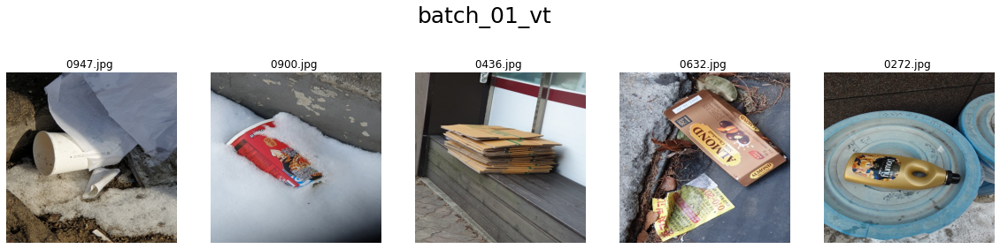

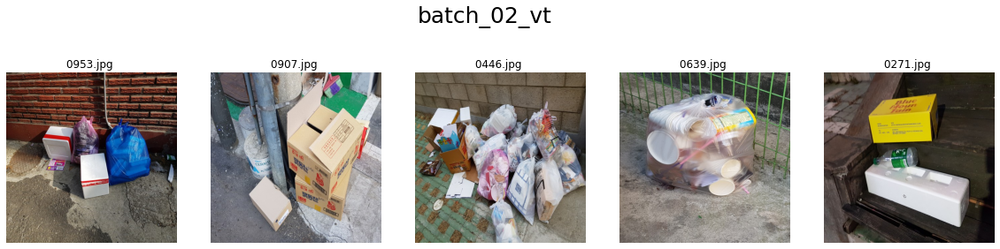

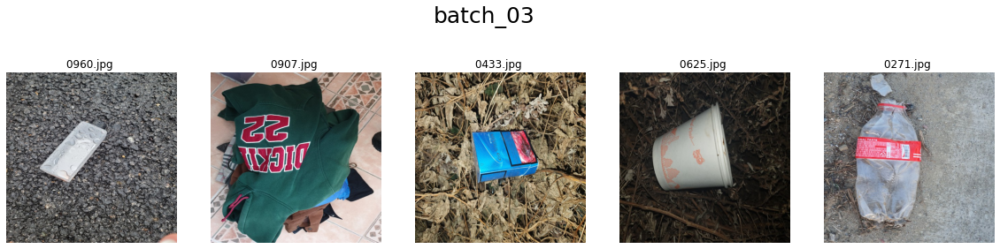

In [79]:
k = 5

for images_list, images_path in zip(total_img_list, IMG_PATH):
    first_k_images = images_list[images_indices][:k]

    folder = images_path.split("/")[-1]

    display_multiple_img(
        images=first_k_images,
        images_path=images_path,
        title = folder,
        cols=5
    )

### read metainfo of the images

In [80]:
metainfo_list = []
total_metainfo_list = []
for images_list, images_path in zip(total_img_list, IMG_PATH):
    metainfo = get_images_metainfo(
        images_list=images_list,
        images_path=images_path
    )

    metainfo_df = pd.DataFrame(metainfo)
    metainfo_list.append(metainfo_df)
    total_metainfo_list += metainfo

100%|██████████| 958/958 [00:00<00:00, 11830.18it/s]


- batch_01_vt

In [81]:
metainfo_list[0]

,imagename,width,height,aspect_ratio
0,0002.jpg,512,512,1.0
1,0003.jpg,512,512,1.0
2,0005.jpg,512,512,1.0
3,0006.jpg,512,512,1.0
4,0007.jpg,512,512,1.0
...,...,...,...,...
1188,1255.jpg,512,512,1.0
1189,1256.jpg,512,512,1.0
1190,1257.jpg,512,512,1.0
1191,1258.jpg,512,512,1.0


- batch_02_vt

In [82]:
metainfo_list[1]

,imagename,width,height,aspect_ratio
0,0001.jpg,512,512,1.0
1,0002.jpg,512,512,1.0
2,0003.jpg,512,512,1.0
3,0004.jpg,512,512,1.0
4,0005.jpg,512,512,1.0
...,...,...,...,...
1953,2002.jpg,512,512,1.0
1954,2003.jpg,512,512,1.0
1955,2004.jpg,512,512,1.0
1956,2005.jpg,512,512,1.0


- batch_03

In [83]:
metainfo_list[2]

,imagename,width,height,aspect_ratio
0,0001.jpg,512,512,1.0
1,0002.jpg,512,512,1.0
2,0003.jpg,512,512,1.0
3,0004.jpg,512,512,1.0
4,0005.jpg,512,512,1.0
...,...,...,...,...
953,0996.jpg,512,512,1.0
954,0997.jpg,512,512,1.0
955,0998.jpg,512,512,1.0
956,0999.jpg,512,512,1.0


### inspect images sizes and aspect ratios

In [84]:
total_metainfo_df = pd.DataFrame(total_metainfo_list)
total_metainfo_df.describe()

,width,height,aspect_ratio
count,4109.0,4109.0,4109.0
mean,512.0,512.0,1.0
std,0.0,0.0,0.0
min,512.0,512.0,1.0
25%,512.0,512.0,1.0
50%,512.0,512.0,1.0
75%,512.0,512.0,1.0
max,512.0,512.0,1.0


# Annotation data

### read json

In [85]:
# json 파일을 읽고 key별로 정보 저장
with open(ANNO_PATH, 'r') as f:
    train_json = json.loads(f.read())
    
images = train_json['images']
categories = train_json['categories']
annotations = train_json['annotations']

# categories_names: category_id와 이름을 매핑해주는 변수
categories_names = []
for cat_dict in categories:
    categories_names.append(cat_dict['name'])
    
# coco: train_json파일을 COCO api형태로 불러온 변수
coco = COCO(ANNO_PATH)

loading annotations into memory...
Done (t=4.47s)
creating index...
index created!


In [86]:
dataset = []

for idx in range(0, len(images)): # length of train images = len(images)
    ann_ids = coco.getAnnIds(imgIds=idx) # 해당 이미지에 해당하는 annotation id들을 저장한 리스트
    ann = coco.loadAnns(ann_ids) # 해당 이미지에 해당하는 annotation 정보를 모두 담은 리스트
    
    for anno in ann:
        for index in range(0, len(categories)):
            if anno['category_id'] == index:
                classname = categories[index]['name']
        dataset.append({'full_filename':images[idx]['file_name'], 'filename' : images[idx]['file_name'].split("/")[-1], 'classname' : classname, **anno})

dataset_df = pd.DataFrame(dataset)
dataset_df

,full_filename,filename,classname,id,image_id,category_id,segmentation,area,bbox,iscrowd
0,batch_01_vt/0002.jpg,0002.jpg,Battery,0,0,8,"[[112, 228, 111, 228, 111, 227, 111, 226, 111,...",6307.5,"[109.0, 150.7, 161.9, 159.8]",0
1,batch_01_vt/0002.jpg,0002.jpg,Battery,1,0,8,"[[482, 248, 481, 248, 480, 248, 480, 247, 479,...",3313.5,"[413.2, 196.1, 72.6, 52.7]",0
2,batch_01_vt/0002.jpg,0002.jpg,Styrofoam,2,0,6,"[[107, 283, 106, 283, 106, 282, 105, 282, 104,...",4741.0,"[42.5, 196.7, 68.3, 86.5]",0
3,batch_01_vt/0002.jpg,0002.jpg,Plastic,3,0,5,"[[111, 462, 110, 462, 109, 462, 108, 462, 107,...",18560.5,"[0.1, 279.7, 117.3, 183.0]",0
4,batch_01_vt/0002.jpg,0002.jpg,Plastic,4,0,5,"[[124, 260, 123, 260, 122, 260, 121, 260, 120,...",9759.0,"[110.3, 77.5, 80.0, 293.4]",0
...,...,...,...,...,...,...,...,...,...,...
26235,batch_03/0997.jpg,0997.jpg,Paper pack,26397,3270,2,"[[0, 180, 0, 180, 0, 179, 0, 178, 0, 177, 0, 1...",1451.5,"[0.0, 97.2, 28.9, 82.9]",0
26236,batch_03/0997.jpg,0997.jpg,Paper pack,26398,3270,2,"[[0, 175, 0, 175, 0, 174, 0, 173, 0, 172, 0, 1...",212.5,"[0.0, 151.4, 17.7, 24.1]",0
26237,batch_03/0997.jpg,0997.jpg,Paper pack,26399,3270,2,"[[5, 408, 4, 408, 3, 408, 2, 408, 1, 408, 0, 4...",14152.5,"[0.0, 261.0, 112.8, 147.7]",0
26238,batch_03/0997.jpg,0997.jpg,Paper pack,26400,3270,2,"[[7, 511, 6, 511, 5, 511, 4, 511, 3, 511, 2, 5...",1044.0,"[0.3, 426.3, 16.7, 85.6]",0


### How much annotations per image we have in the dataset?

In [87]:
print(f"하나의 이미지당 bounding box 개수 평균: {dataset_df.groupby('filename')['bbox'].count().mean():.2f}")

하나의 이미지당 bounding box 개수 평균: 14.42


## How much samples per category we have in the dataset?

['Battery' 'Styrofoam' 'Plastic' 'Paper' 'Glass' 'Paper pack' 'Metal'
 'Plastic bag' 'Clothing']


<AxesSubplot:xlabel='classname', ylabel='count'>

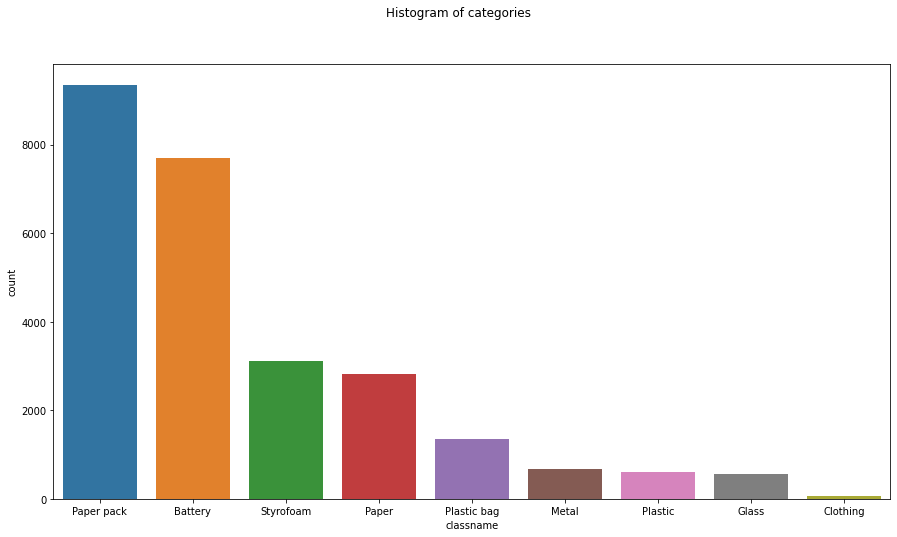

In [88]:
print(dataset_df['classname'].unique())

plt.figure(figsize = (15,8))
plt.suptitle('Histogram of categories')
sns.countplot(data=dataset_df, x='classname', order=dataset_df['classname'].value_counts().index)

### What is the area of the boxes we have in the dataset?

<AxesSubplot:xlabel='area', ylabel='Count'>

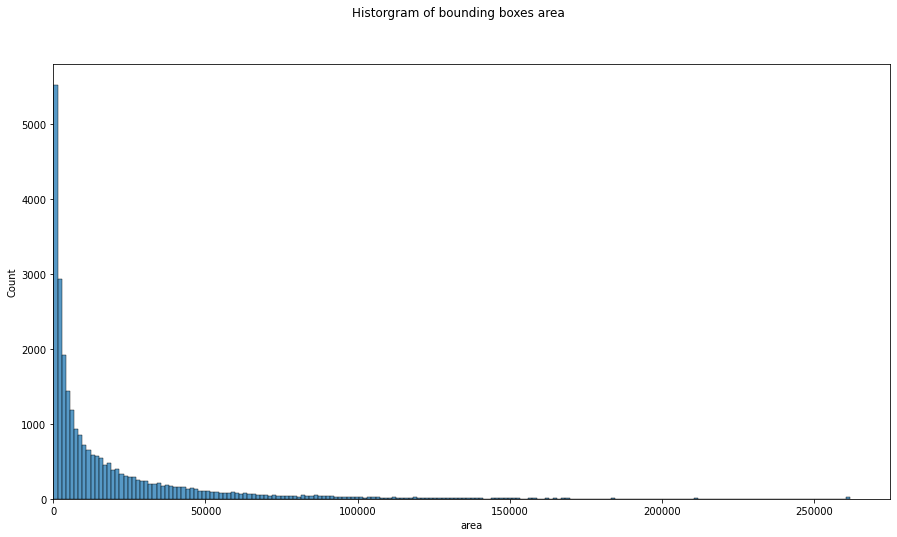

In [89]:
dataset_df['area'] = dataset_df['bbox'].apply(lambda x: (x[2]) * (x[3]))

plt.figure(figsize = (15,8))
plt.xlim([0, 275142.932]) # min, max = plt.xlim()
plt.suptitle('Historgram of bounding boxes area')
sns.histplot(data=dataset_df, x='area')

In [90]:
dataset_df['area'].describe()

count     26240.000000
mean      18132.308913
std       28430.991272
min          15.170000
25%        1770.075000
50%        6961.705000
75%       22040.655000
max      262041.610000
Name: area, dtype: float64

<AxesSubplot:xlabel='classname', ylabel='area'>

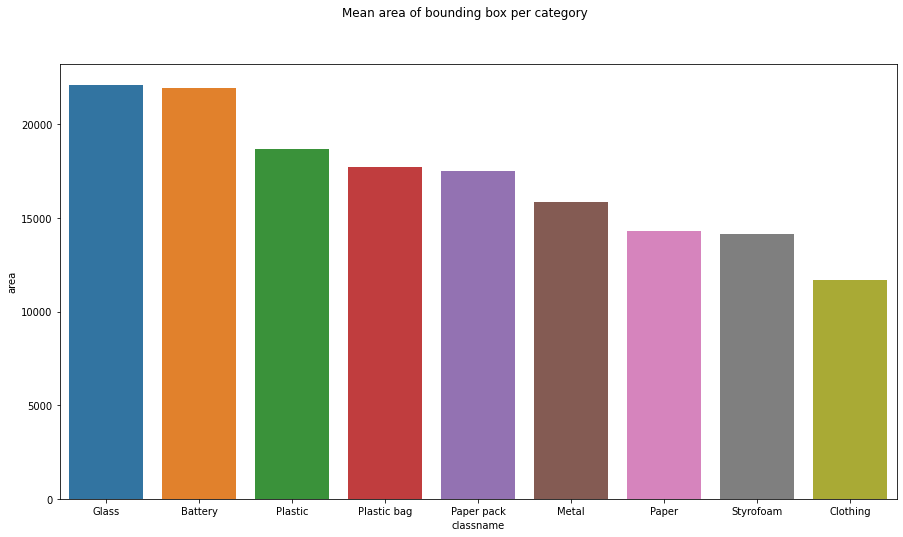

In [91]:
agg_by_classname = dataset_df.groupby('classname')['area',].mean().sort_values('area', ascending=False)

plt.figure(figsize = (15,8))
plt.suptitle('Mean area of bounding box per category')
sns.barplot(data=agg_by_classname, x=agg_by_classname.index, y='area')

### Visualize aspect ratio for bounding boxes in the annotations

<AxesSubplot:xlabel='box_ratio', ylabel='Count'>

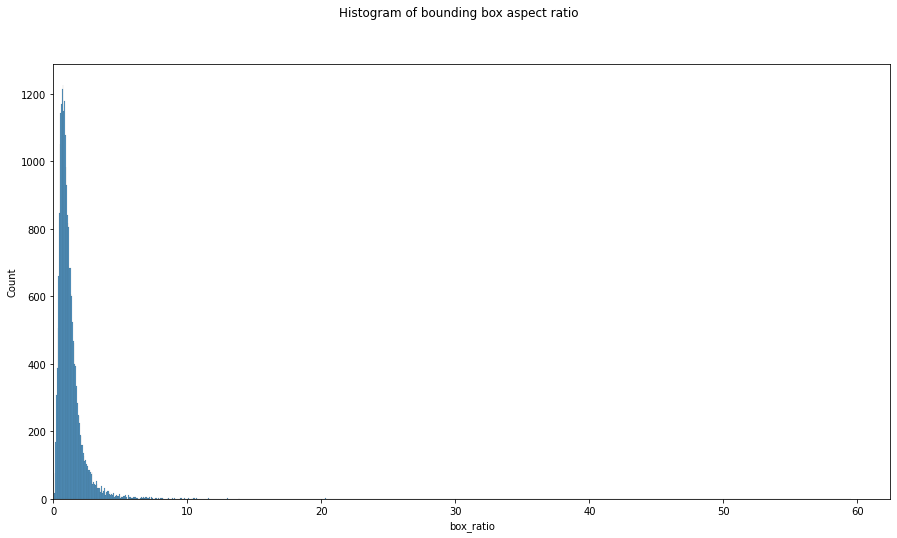

In [92]:
def count_box_ratio(x):
    try:
        return (x[2]) / (x[3])
    except ZeroDivisionError as e:
        return 0

dataset_df['box_ratio'] = dataset_df['bbox'].apply(count_box_ratio)

plt.figure(figsize = (15,8))
plt.xlim([0, 62.47308638600328]) # min, max = plt.xlim()
plt.suptitle('Histogram of bounding box aspect ratio')
sns.histplot(data=dataset_df, x='box_ratio')

# Visualize dataset annotations

### Visualize bounding box

In [93]:
def grouper(iterable, n, fillvalue=None):
    """Collect data into fixed-length chunks or blocks"""
    
    args = [iter(iterable)] * n
    return zip_longest(*args, fillvalue=fillvalue)

### Visualize segmentation

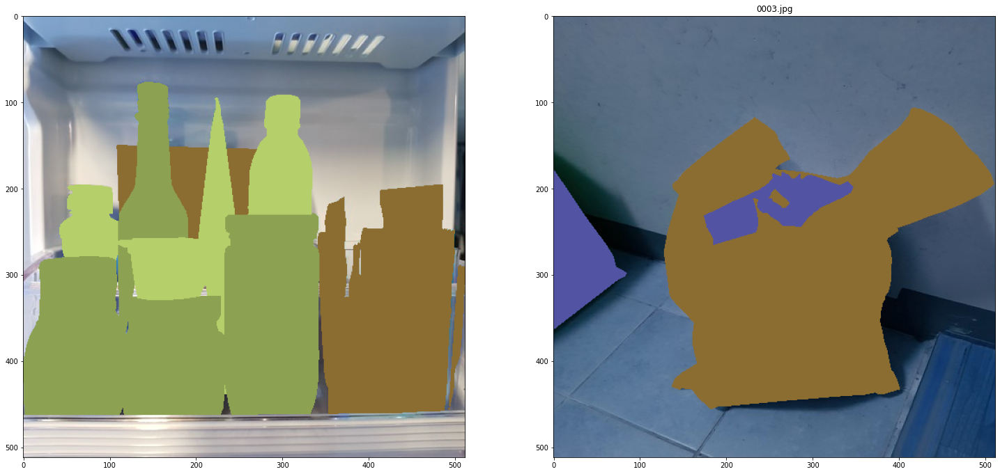

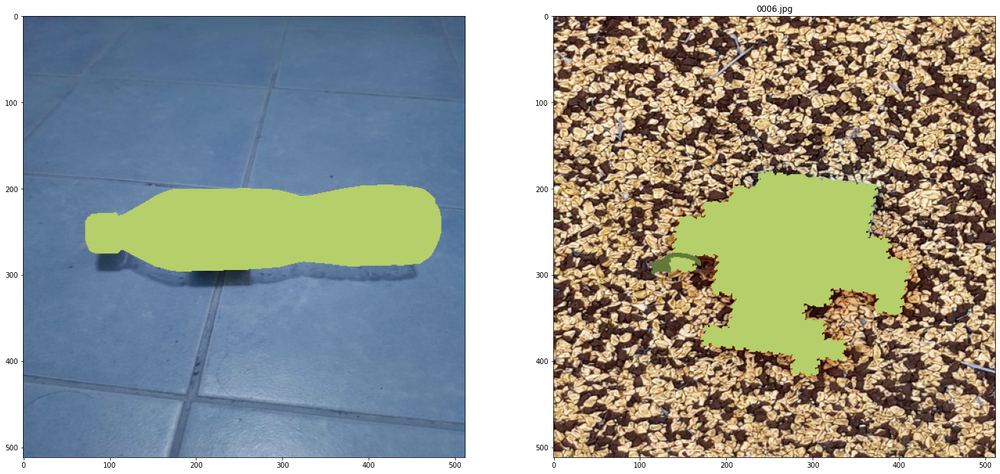

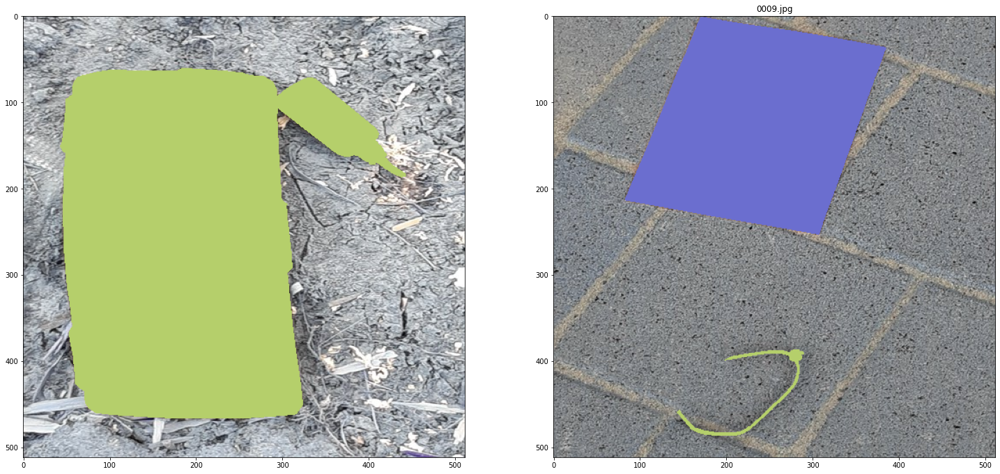

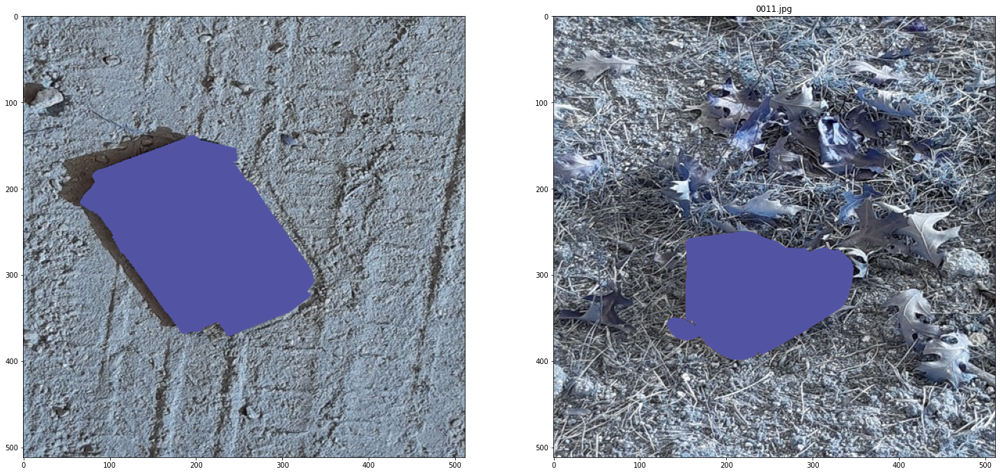

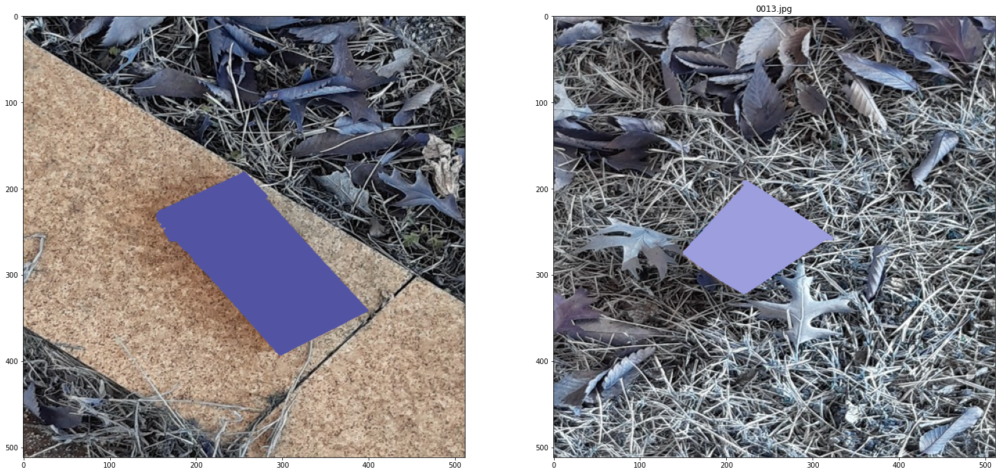

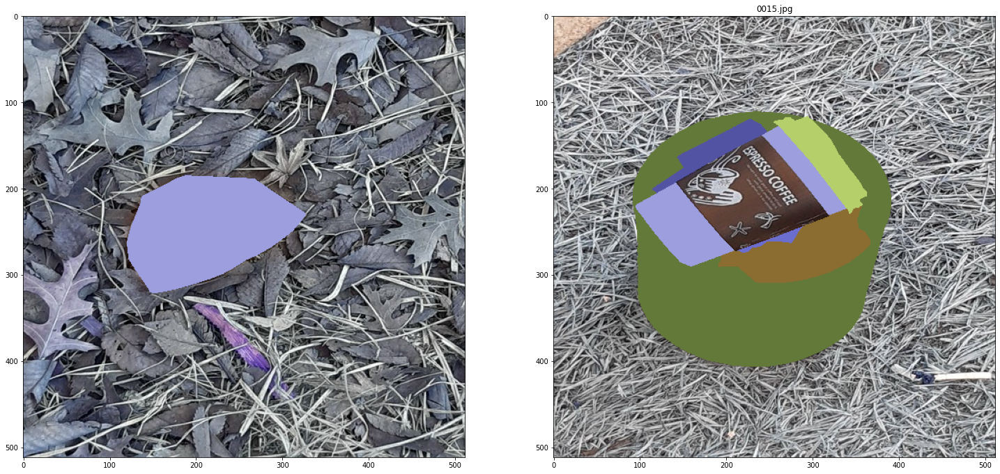

In [95]:
cols = 2
limit = 50

cmap = plt.get_cmap('tab20b')
colors = [cmap(i) for i in np.linspace(0, 1, 20)]

dataset_grouped = grouper(dataset_df[:limit].groupby('filename'), n=2)


for _, grouped_pairs in enumerate(dataset_grouped):
    figure, ax = plt.subplots(nrows = 1, ncols = cols, figsize = (25, 25))

    for index, current_sample in enumerate(grouped_pairs):
        if not current_sample:
            break

        (imagename, sample) = current_sample
        
        image = cv2.imread(
            os.path.join(DATA_ROOT, sample['full_filename'].values[0])
        )


        for i, row in sample.iterrows():
            color = colors[int(row['category_id']) % len(colors)] # category_id에 따라 색상 선정
            color = [i * 255 for i in color]
            
            seg = row['segmentation']

            mask = []
            for s in seg:
                polygon = []
                for j in range(0, len(s)):
                    if j % 2 == 1 :
                        polygon.append([s[j-1], s[j]])
                polygon = np.array(polygon)
                cv2.fillPoly(image, [polygon], color)

        ax[ind].set_title(imagename)
        ax[index].imshow(image)


### Visualization bbox + mask

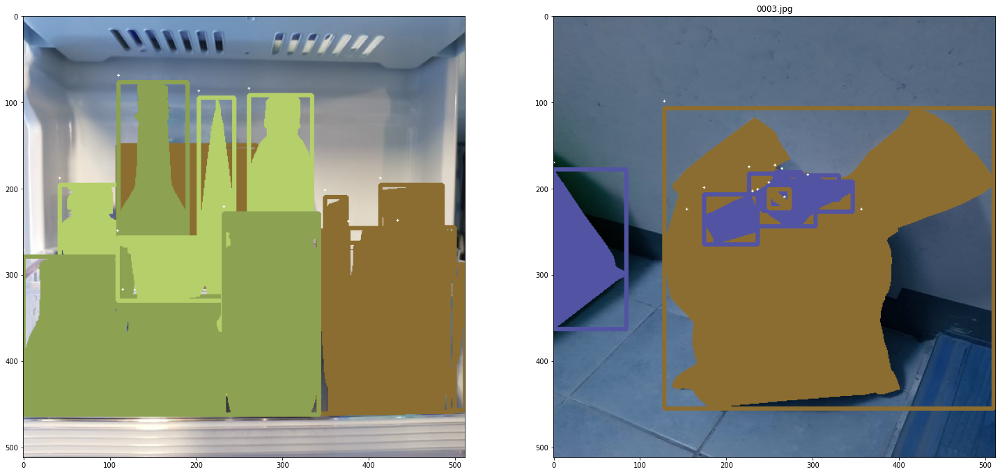

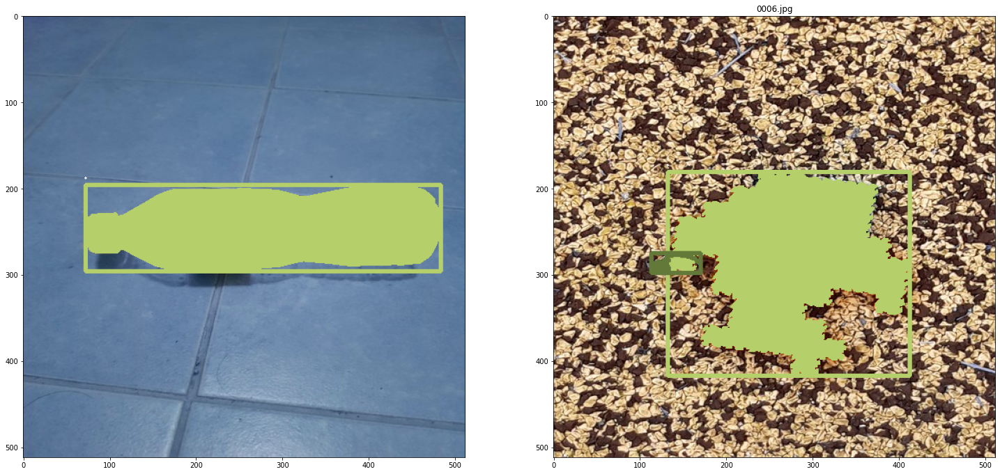

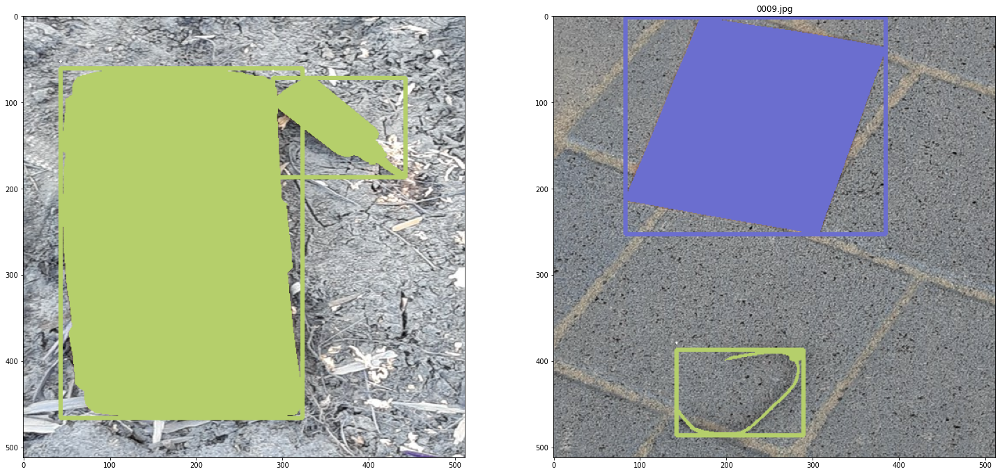

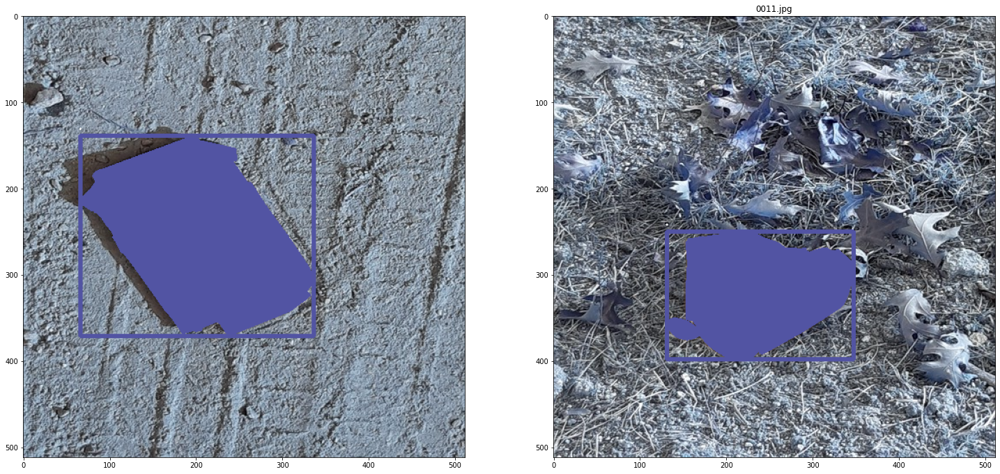

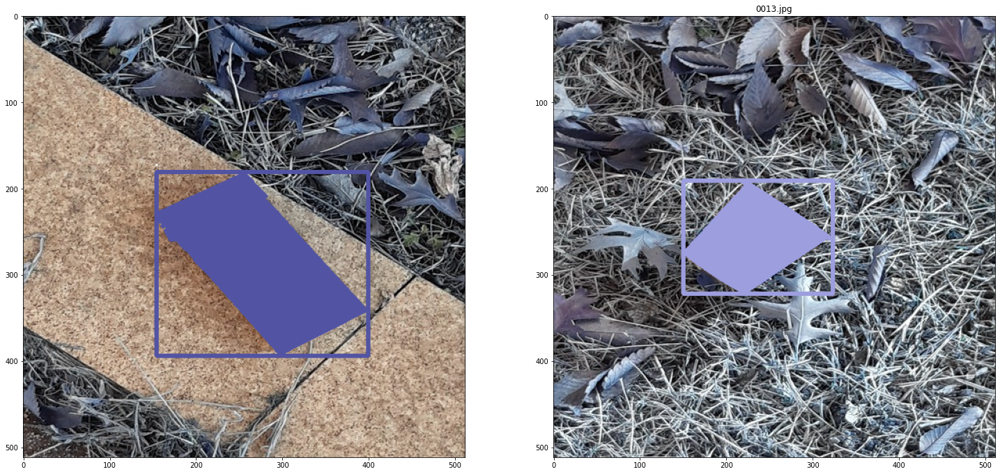

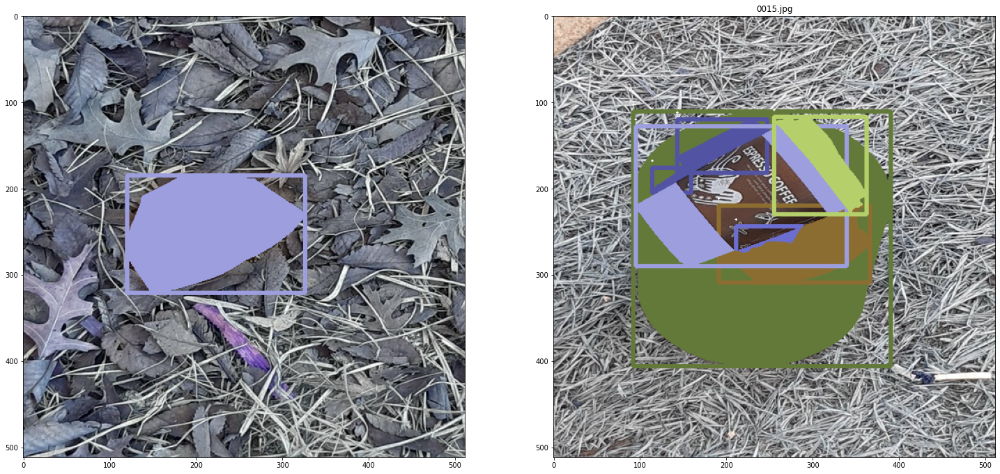

In [96]:
cols = 2
limit = 50

cmap = plt.get_cmap('tab20b')
colors = [cmap(i) for i in np.linspace(0, 1, 20)]

dataset_grouped = grouper(dataset_df[:limit].groupby('filename'), n=2)


for _, grouped_pairs in enumerate(dataset_grouped):
    figure, ax = plt.subplots(nrows = 1, ncols = cols, figsize = (25, 25))

    for index, current_sample in enumerate(grouped_pairs):
        if not current_sample:
            break

        (imagename, sample) = current_sample
        
        image = cv2.imread(
            os.path.join(DATA_ROOT, sample['full_filename'].values[0])
        )


        for i, row in sample.iterrows():
            color = colors[int(row['category_id']) % len(colors)] # category_id에 따라 색상 선정
            color = [i * 255 for i in color]
            
            seg = row['segmentation']

            mask = []
            for s in seg:
                polygon = []
                for j in range(0, len(s)):
                    if j % 2 == 1 :
                        polygon.append([s[j-1], s[j]])
                polygon = np.array(polygon)
                cv2.fillPoly(image, [polygon], color)


            coordinates = [
                (row['bbox'][0], row['bbox'][1]),
                (row['bbox'][0]+row['bbox'][2], row['bbox'][1]+row['bbox'][3]),
            ]

            cv2.rectangle(img=image, pt1=(int(coordinates[0][0]), int(coordinates[0][1])), pt2=(int(coordinates[1][0]), int(coordinates[1][1])), color=color, thickness=int(4*image.shape[1]/640))
            cv2.putText(image, row['classname'], 
                        (int(coordinates[0][0]), int(coordinates[0][1] - int(10*image.shape[1]/640))), cv2.FONT_HERSHEY_SIMPLEX, 
                        int(1*image.shape[1]/640), (255,255,255), int(3*image.shape[1]/640))

        ax[ind].set_title(imagename)
        ax[index].imshow(image)